# QUICK INTRO TO YOLOv3

YOLO fundamental approach for an input image divided into 13x13 grid, and assuming 3 anchors considered:
![](https://machinelearningspace.com/wp-content/uploads/2020/01/bbox_ok-2.png)

The actual YOLOv3 implements this kinda detection at 3 scales.
At each scale the output tensor (*feature-map*) will be of shape <13, 13, (3)(5+80)>

80 = number of static classnames from COCO.names


The file yolov3.cfg contains all information related to the YOLOv3 architecture and its parameters, whereas the file yolov3.weights contains the convolutional neural network (CNN) parameters of the YOLOv3 pre-trained weights.

### Note- 
> I've implemented the Yolov3 algorithm in Tensorflow v1 with additional code-explainations as well. This notebook serves as a high level overview and implementation, since we've used the official Yolov3 config file and weights, to load the model.

In [1]:
import numpy as np, pandas as pd, tensorflow as tf, os, cv2
from tensorflow.keras import Model
from tensorflow.keras.layers import Conv2D, LeakyReLU, BatchNormalization, Input, UpSampling2D, ZeroPadding2D, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, TensorBoard, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam

import urllib.request as urlr
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display
from seaborn import color_palette, palplot

for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        pass

### Yolo-v3 network structure:
The below function will read the offical _**yolov3.cfg**_ file and generate a list of blocks containing a dictionary of layers. We'll be parsing the config file, retrieving the blocks of layers as per above format, and then stacking up layers.

Just glance at the config file format and this function will be easily understood.

We're essentially trying to accomplish the following Yolo-v3 network structure:

![Yolo-v3 network structure](https://www.researchgate.net/publication/335865923/figure/fig1/AS:804106595758082@1568725360777/Structure-detail-of-YOLOv3It-uses-Darknet-53-as-the-backbone-network-and-uses-three.jpg)

In [2]:
def parse_config_file(configfile):
    
    with open(configfile,'r') as fullfile:
        lines=[line.rstrip('\n') for line in fullfile if line[0]!='#' and line!='\n']
    
    #'lines' now holds the entire content of configfile with unnecessary '#' and only-newline occurences skipped
    
    
    holder={}    #will be used as a dictionary to hold all <layer_info:value> pairs in a particular block
    blocks=[]
    
    for line in lines:
        if line[0]=='[':
            #if a new block of layers is starting
            line= 'type=' + line[1:-1].rstrip()
            if len(holder)!=0:
                blocks.append(holder)
                holder={}
        key,value=line.split('=')
        holder[key.rstrip()]=value.lstrip()
    
    blocks.append(holder)
    
    return blocks




def YoloV3Net(configfile, model_size, n_classes):
    
    blocks=parse_config_file(configfile)
    
    outputs={}
    output_filters=[]
    filters=[]
    out_pred=[]
    scale=0
    
    inputs = input_image = Input(model_size)
    inputs/=255.
    
    for i,block in enumerate(blocks[1:]):
        
        #MAIN CONVOLUTIONAL LAYER LOGIC WITH AND WITHOUT BATCH-NORMALIZATION
        if block['type'] == 'convolutional':
            activation = block['activation']
            filters = int(block['filters'])
            kernel_size = int(block['size'])
            strides = int(block['stride'])
            padding='same'
            
            if strides>1:
                inputs=ZeroPadding2D(padding=((1,0),(1,0))) (inputs)  #to avoid downsampling
                padding='valid'
            
            inputs=Conv2D(
                kernel_size=kernel_size, filters=filters, strides=strides, padding=padding, 
                use_bias=False if 'batch_normalize' in block else True, name='conv_'+str(i)
            )(inputs)
            
            if 'batch_normalize' in block:
                inputs=BatchNormalization(name='batchNorm_'+str(i))(inputs)
                inputs=LeakyReLU(alpha=0.1, name ='leaky_'+str(i))(inputs)
                
                
        #UPSAMPLE LAYER LOGIC TO AVOID DOWNSAMPLING AND LOSING INFORMATION FROM PREVIOUS FEATURE-MAP
        elif block['type']=='upsample':
            stride = int(block['stride'])
            inputs=UpSampling2D(size=stride)(inputs)
            
            
        
        elif block['type']=='route':
            block['layers']=block['layers'].split(',')
            start=int(block['layers'][0])
            
            if len(block['layers'])>1:
                end=int(block['layers'][1])-i
                filters=output_filters[i+start] + output_filters[end]
                inputs=tf.concat([outputs[i+start],outputs[i+end]],axis=-1)
            else:
                filters=output_filters[i+start]
                inputs=outputs[i+start]
                
                
        #SKIP CONNECTION LOGIC
        elif block['type']=='shortcut':
            from_=int(block['from'])
            inputs=outputs[i-1] + outputs[i+from_]
            
            
            
        #PREDICTION LAYER LOGIC
        elif block['type']=='yolo':
            mask = block['mask'].split(',')
            mask=[int(i) for i in mask]
            anchors = block['anchors'].split(',')
            anchors=[(int(anchors[i]),int(anchors[i+1])) for i in range(0,len(anchors),2)]
            anchors=[anchors[i] for i in mask]
            n_anchors=len(anchors)
            
            out_shape=inputs.get_shape().as_list()
            
            inputs=tf.reshape(tensor=inputs,shape=(-1, n_anchors*out_shape[1]*out_shape[2], 5+n_classes))
            
            box_centers=inputs[:,:,:2]
            box_shapes=inputs[:,:,2:4]
            confidence=inputs[:,:,4:5]
            classes=inputs[:,:,5:n_classes+5]
            
            
            box_centers=tf.nn.sigmoid(box_centers)
            confidence=tf.nn.sigmoid(confidence)
            classes=tf.nn.sigmoid(classes)
            
            anchors=tf.tile(anchors, [out_shape[1]*out_shape[2], 1])
            box_shapes=tf.exp(box_shapes) * tf.cast(anchors,dtype=tf.float32)
            
            x=tf.range(out_shape[1],dtype=tf.float32)
            y=tf.range(out_shape[2],dtype=tf.float32)
            
            cx,cy=tf.meshgrid(x,y)
            cx=tf.reshape(cx,(-1,1))
            cy=tf.reshape(cy,(-1,1))
            cxy=tf.concat([cx,cy],axis=-1)
            cxy=tf.tile(cxy,[1,n_anchors])
            cxy=tf.reshape(cxy,[1,-1,2])
            
            strides=(input_image.shape[1]//out_shape[1] , input_image.shape[2]//out_shape[2])
            
            box_centers = (box_centers+cxy)*strides
            #print("i=",i)
            #print(box_centers.shape,box_shapes.shape,confidence.shape,classes.shape,"\n\n")
            prediction=tf.concat([box_centers,box_shapes,confidence,classes],axis=-1)
            
            
            if scale:
                #for 2nd and 3rd scale prediction
                out_pred=tf.concat([out_pred,prediction],axis=1)
            else:
                #for 1st scale prediction
                out_pred=prediction
                scale=1
        
        
        #TO KEEP TRACK OF PREVIOUS LAYERS' INPUTS FOR PURPOSES OF 'shortcut' AND 'route' LAYERS
        outputs[i]=inputs
        output_filters.append(filters)
    
    model=Model(input_image,out_pred)
    model.summary()
    return model

In [3]:
def load_weights(model, config_file, weights_file):
    fp=open(weights_file,'rb')
    
    #skip the first 5 values from the weights file
    np.fromfile(fp, dtype=np.int32, count=5)
    
    blocks=parse_config_file(config_file)
    
    for i, block in enumerate(blocks[1:]):
        if block['type']=='convolutional':
            conv_layer=model.get_layer('conv_'+str(i))
            print('layer: ',i+1,conv_layer)
            
            filters=conv_layer.filters
            kernel_size=conv_layer.kernel_size[0]
            in_dim=conv_layer.input_shape[-1]
            
            if 'batch_normalize' in block:
                norm_layer=model.get_layer('batchNorm_'+str(i))
                print('layer: ',i+1,norm_layer)
                bn_weights=np.fromfile(fp, dtype=np.float32, count=4*filters)
                size=np.prod(norm_layer.get_weights()[0].shape)
                
                #in the weights file BatchNorm weights for 1 filter are stored as [gamma,beta,mean,variance]
                #but we want [beta,gamma,mean,variance], hence the reshape below
                bn_weights=bn_weights.reshape(4,filters)[[1,0,2,3]]  
                
            else:
                conv_bias=np.fromfile(fp, dtype=np.float32, count=filters)
        
            #darknet shape [out_dim, in_dim, height, width]
            conv_shape=(filters, in_dim, kernel_size, kernel_size)
            conv_weights=np.fromfile(fp, dtype=np.float32, count=np.product(conv_shape))
            
            #tensorflow shape [height, width, in_dim, out_dim]
            conv_weights=conv_weights.reshape(conv_shape).transpose([2,3,1,0])
            
            if 'batch_normalize' in block:
                norm_layer.set_weights(bn_weights)
                conv_layer.set_weights([conv_weights])
            else:
                conv_layer.set_weights([conv_weights,conv_bias])
            
    assert len(fp.read())==0, 'Failed to read all data'
    fp.close()
            

# TESTING MODEL'S SKELETON
The following cell attempts to load the pre-trained weights into the model skeleton that we created earlier from the config file.

In [4]:
weights_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/yolov3.weights'
config_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/yolov3.cfg'
class_names_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/coco.names'
font_path='../input/yolov3weightsconfigdataset/futur.ttf'
images=['../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Flowers.jpg','../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Manly_beach.jpg']

model_size=(416,416,3)
num_classes=80
max_output_size=40
max_output_size_per_class=20
iou_threshold=.6
confidence_threshold=.6

yolomodel=YoloV3Net(configfile=config_file, model_size=model_size, n_classes=num_classes)
load_weights(model=yolomodel, config_file=config_file, weights_file=weights_file)

try:
    wfile='yolov3_weights.tf'
    yolomodel.save_weights(wfile)
    print('The model\'s weights have been saved successfully at {}'.format(wfile))
except IOError:
    print('Couldn\'t write the file \'yolov3_weights.tf\'')

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
tf_op_layer_RealDiv (TensorFlow [(None, 416, 416, 3) 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv_0 (Conv2D)                 (None, 416, 416, 32) 864         tf_op_layer_RealDiv[0][0]        
__________________________________________________________________________________________________
batchNorm_0 (BatchNormalization (None, 416, 416, 32) 128         conv_0[0][0]                     
______________________________________________________________________________________________

# UTILITY FUNCTIONS

### NON-MAX SUPPRESSION
* Split the input into (x,y,w,h,conf,[classes]) along last axis

* At the crux of this Yolo implementation, non-max suppression is accomplished by using the Tensorflow v2 in-built function
> tf.image.combined_non_max_suppression()

### LOAD CLASS-NAMES
* Returns an array of 80 class-names from 'coco.names'
> Objects that can be detected (ex- dog, cat, person, ...)

### OUTPUT BOXES
* Re-splits the input feature-map into (x,y,w,h,conf,[classes]) along last axis, and calculates (xmin,ymin) , (xmax,ymax).

* Invokes the above non-max suppression function, and retrieves (boxes,scores,classes,num_valid_detections)

### DRAW BOXES
* Extract the actual boxes, scores, classes, and number of valid_detections.

    * Create an n-d array of seaborn module's color-palette
    
    * Open the Image and link it to a drawable object
    
    * For each of our predicted bounding boxes:
        
        * Choose that box of 4 co-ordinates and scale their values up by the real image's size
        
        * Calculate 't' values of thickness between 0-1 using np.linspace()
        > for ex.- the 't' values could be [0, 0.25, 0.5, 0.75, 1.0] if thickness=2

        * Draw rectangles using these 't' values to mimic thick dark lines
        
        * Print the text using some simple draw functions

In [5]:
def non_max_suppression(inputs, model_size, max_output_size, max_output_size_per_class, confidence_threshold, iou_threshold):
    '''
        'max_output_size' ie max_total_size => total # of bounding boxes predictions for all classes combined
        'max_output_size_per_class'         => total # of bounding boxes predictions for each class
    '''
    bbox, confidence, classes_probs=tf.split(inputs,[4,1,-1],axis=-1)
    bbox=bbox/model_size[0]
    
    scores=confidence*classes_probs
    boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
        boxes=tf.reshape(bbox, (tf.shape(bbox)[0],-1,1,4)),
        scores=tf.reshape(scores, (tf.shape(scores)[0],-1,tf.shape(scores)[-1])),
        max_total_size=max_output_size, max_output_size_per_class=max_output_size_per_class,
        score_threshold=confidence_threshold, iou_threshold=iou_threshold
    )
    return boxes,scores,classes,valid_detections



def resize_image(inputs,model_size):
    inputs=image.resize(size=(model_size[0],model_size[1]))
    return inputs



def load_class_names(file_name):
    with open(file_name,'r') as fp:
        classnames=fp.read().splitlines()
    return classnames


def output_boxes(inputs, model_size, max_output_size, max_output_size_per_class, score_threshold, iou_threshold):
    
    x, y, w, h, confidence, classes_probs= tf.split(inputs,[1,1,1,1,1,-1],axis=-1)
    
    topleft_x     = x - w/2.
    topleft_y     = y - h/2.
    bottomright_x = x + w/2.
    bottomright_y = y + h/2.
    
    inputs=tf.concat([topleft_x,topleft_y,bottomright_x,bottomright_y,confidence, classes_probs],axis=-1)
    
    boxes_dicts = non_max_suppression(inputs, model_size, max_output_size, max_output_size_per_class, score_threshold, iou_threshold)
    #(boxes,scores,classes,valid_detections)
    
    return boxes_dicts



def draw_boxes_in_PIL(image_path, class_names, font_path, model_size, boxes, confidence, classes, nums):
    '''
        nums     => Number of boxes to draw
        boxes    => Actual box 4 coordinates topleft (x,y) and bottomright (x,y) with values between 0-1
    '''
    print('Welcome to the draw_boxes_in_PIL() function.\n\nIMPORTANT: We\'ll be resizing the predictions of box coordinates by size of image itself!')
    boxes, confidence, classes, nums = boxes[0], confidence[0], classes[0], nums[0]
    print('nums=',nums,'\n\nboxes.shape=',boxes.shape)           
                                                           #   =====> nums=3   and boxes=<40,4> with data
    colors=((255 * np.array(color_palette(palette='hls', n_colors=len(class_names)) ) )).astype(int)
    
    
    if 'http' in image_path:
        image=Image.open(urlr.urlopen(image_path))
    else:
        image=Image.open(image_path)
    drawable=ImageDraw.Draw(image)
    font = ImageFont.truetype(font=font_path, size=(image.size[0] + image.size[1]) // 100)
    print('\nOriginal image.size=',image.size)             #   =====> image=<3024,4032>
    
    resize_factor= (image.size[0], image.size[1])          # Don't divide by the model_size, since this implementation predicts values betn 0-1
    print('resize_factor=',resize_factor)                  #   =====> resize_factor=(7.3 , 9.7)
    
    for i in range(nums):
        color=colors[i]
        xy=boxes[i,0:4]
        xy = [xy[j] * resize_factor[j % 2] for j in range(4)]
        x0,y0 = xy[0], xy[1]
        
        thickness = (image.size[0] + image.size[1]) // 200
        for t in np.linspace(0, 1, thickness):
            xy[0], xy[1] = (xy[0] + t) , (xy[1] + t)          #adjusting top left x and y
            xy[2], xy[3] = (xy[2] - t) , (xy[3] - t)          #adjusting bottom right x and y
            drawable.rectangle(xy, outline=tuple(color))
        
        text = '{} {:.1f}%'.format(class_names[int(classes[i])], confidence[i] * 100)
                    
        text_size = drawable.textsize(text, font=font)
                    
        drawable.rectangle( [x0, y0 - text_size[1], x0 + text_size[0], y0],   fill=tuple(color))
                    
        drawable.text((x0, y0 - text_size[1]), text, fill='black', font=font)
    
    display(image)

# RUNNING THE MODEL (USING PIL LIBRARY)

Now, we can begin with model predictions based on the pretrained YOLOv3 model that we loaded.

* Begin by preprocessing the image-file to bring it to expected size - 416x416

* Push the image into the model using yolomodel.predict() function

* Retrieve the boxes and remember, our boxes are predicted values only between 0-1

* Hence, to display the boxes, don't forget to multiply the co-ordinates by original image-size value

Image being preprocessed for prediction=  ../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Madame Toussades-III.jpg
	image.size for prediction=( 2617 , 1805 )
	resized_image.size for prediction= (416, 416)
	resized_image.shape for prediction= (1, 416, 416, 3)
	Predictions.shape= (1, 10647, 85)
	Predicted boxes.shape= (1, 40, 4)


################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################


Welcome to the draw_boxes_in_PIL() function.

IMPORTANT: We'll be resizing the predictions of box coordinates by size of image itself!
nums= tf.Tensor(4, shape=(), dtype=int32) 

boxes.shape= (40, 4)

Original image.size= (2617, 1805)
resize_factor= (2617, 1805)


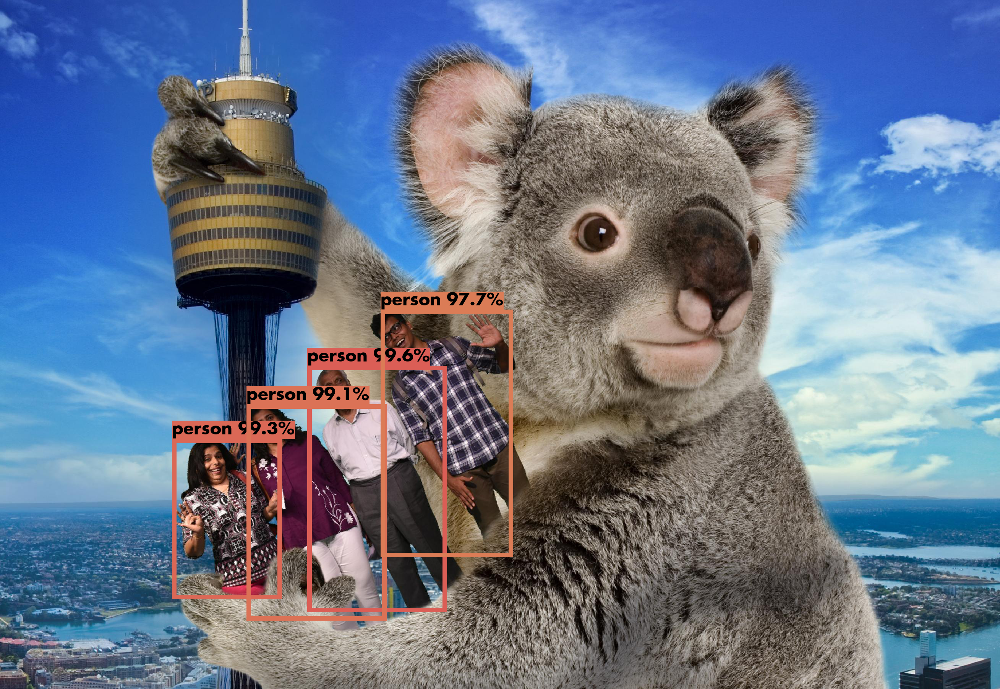

Image being preprocessed for prediction=  ../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Manly_beach.jpg
	image.size for prediction=( 3024 , 4032 )
	resized_image.size for prediction= (416, 416)
	resized_image.shape for prediction= (1, 416, 416, 3)
	Predictions.shape= (1, 10647, 85)
	Predicted boxes.shape= (1, 40, 4)


################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################


Welcome to the draw_boxes_in_PIL() function.

IMPORTANT: We'll be resizing the predictions of box coordinates by size of image itself!
nums= tf.Tensor(3, shape=(), dtype=int32) 

boxes.shape= (40, 4)

Original image.size= (3024, 4032)
resize_factor= (3024, 4032)


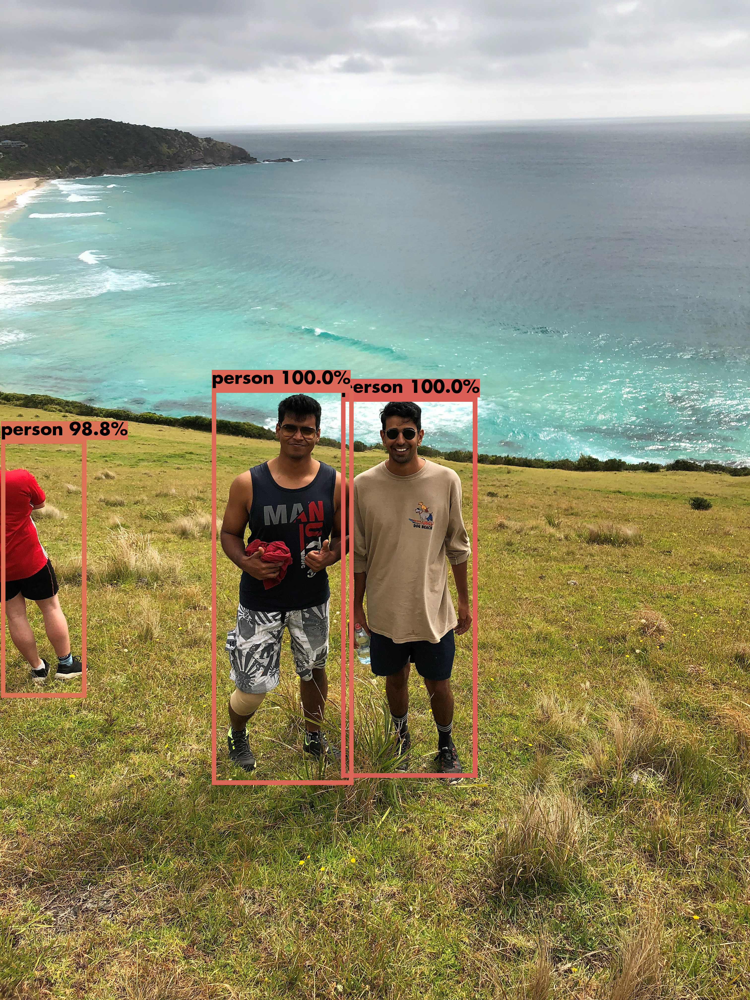

Image being preprocessed for prediction=  https://images-na.ssl-images-amazon.com/images/I/81nwy-sys5L._SL1500_.jpg
	image.size for prediction=( 1201 , 1500 )
	resized_image.size for prediction= (416, 416)
	resized_image.shape for prediction= (1, 416, 416, 3)
	Predictions.shape= (1, 10647, 85)
	Predicted boxes.shape= (1, 40, 4)


################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################


Welcome to the draw_boxes_in_PIL() function.

IMPORTANT: We'll be resizing the predictions of box coordinates by size of image itself!
nums= tf.Tensor(4, shape=(), dtype=int32) 

boxes.shape= (40, 4)

Original image.size= (1201, 1500)
resize_factor= (1201, 1500)


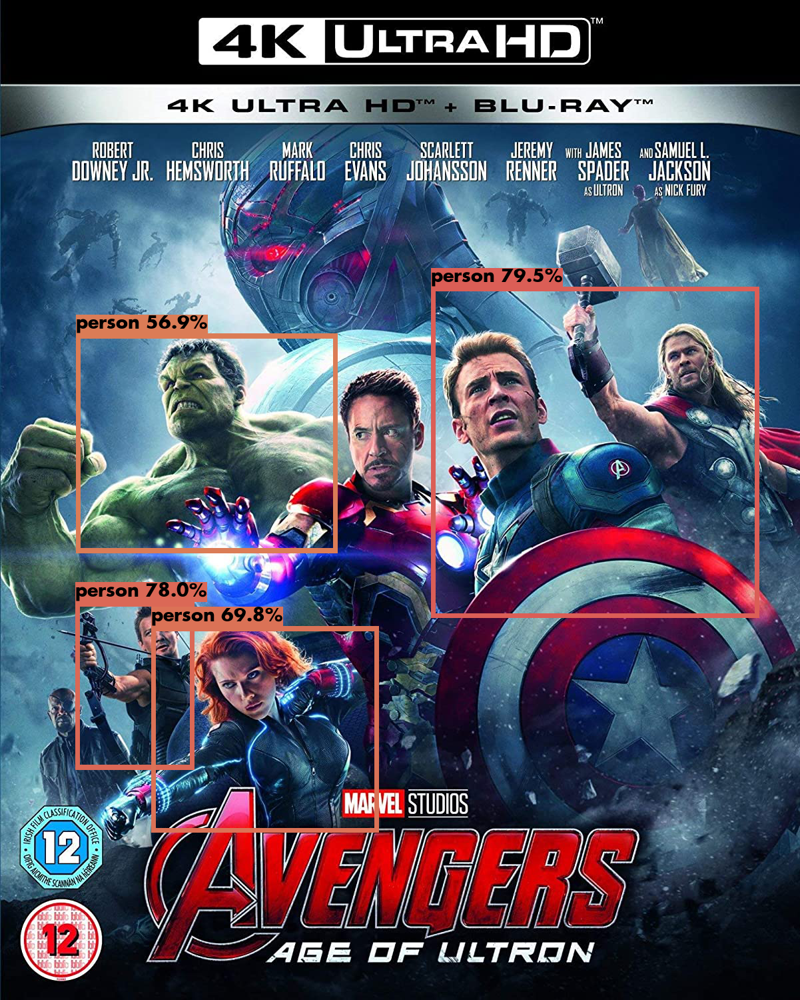

Image being preprocessed for prediction=  https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSoFbdE6jbpy3U1qbytmNvZW7o_mqJAPcLjtIg2NYZkL8srLbM9&usqp=CAU
	image.size for prediction=( 299 , 168 )
	resized_image.size for prediction= (416, 416)
	resized_image.shape for prediction= (1, 416, 416, 3)
	Predictions.shape= (1, 10647, 85)
	Predicted boxes.shape= (1, 40, 4)


################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################


Welcome to the draw_boxes_in_PIL() function.

IMPORTANT: We'll be resizing the predictions of box coordinates by size of image itself!
nums= tf.Tensor(9, shape=(), dtype=int32) 

boxes.shape= (40, 4)

Original image.size= (299, 168)
resize_factor= (299, 168)


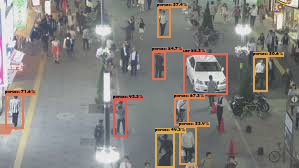

Image being preprocessed for prediction=  https://upload.wikimedia.org/wikipedia/commons/2/2f/Culinary_fruits_front_view.jpg
	image.size for prediction=( 3818 , 2540 )
	resized_image.size for prediction= (416, 416)
	resized_image.shape for prediction= (1, 416, 416, 3)
	Predictions.shape= (1, 10647, 85)
	Predicted boxes.shape= (1, 40, 4)


################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################


Welcome to the draw_boxes_in_PIL() function.

IMPORTANT: We'll be resizing the predictions of box coordinates by size of image itself!
nums= tf.Tensor(15, shape=(), dtype=int32) 

boxes.shape= (40, 4)

Original image.size= (3818, 2540)
resize_factor= (3818, 2540)


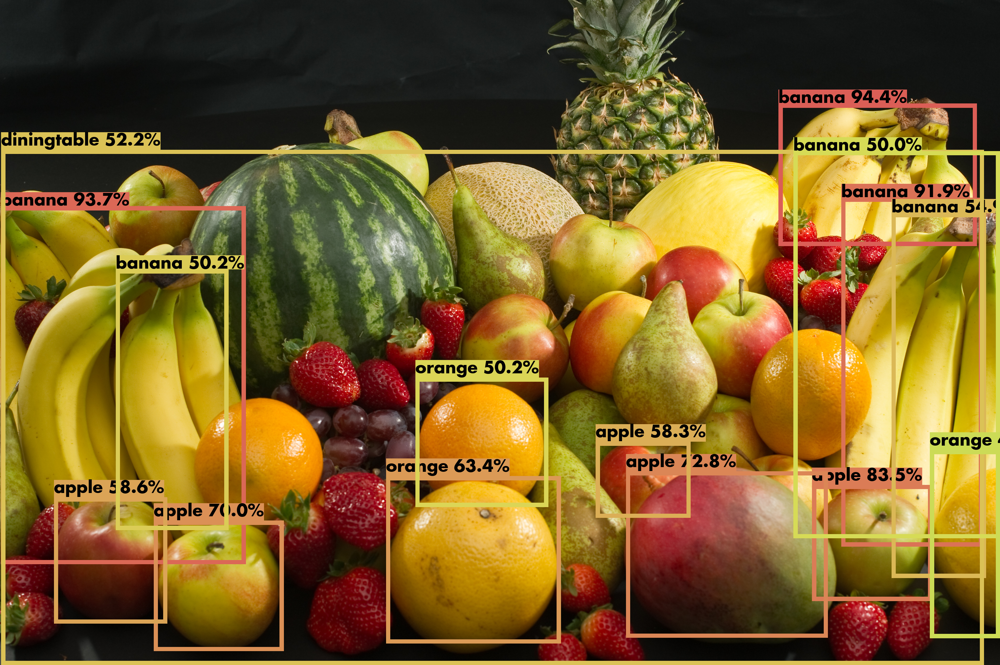

In [6]:
weights_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/yolov3.weights'
config_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/yolov3.cfg'
class_names_file='../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/coco.names'
font_path='../input/yolov3weightsconfigdataset/futur.ttf'
images=['../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Madame Toussades-III.jpg',
        '../input/yolov3weightsconfigdataset/YOLOv3_Weights_Config_Dataset/Manly_beach.jpg',
        'https://images-na.ssl-images-amazon.com/images/I/81nwy-sys5L._SL1500_.jpg',
        'https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcSoFbdE6jbpy3U1qbytmNvZW7o_mqJAPcLjtIg2NYZkL8srLbM9&usqp=CAU',
        'https://upload.wikimedia.org/wikipedia/commons/2/2f/Culinary_fruits_front_view.jpg'
       ]

class_names=load_class_names(class_names_file)
model_size=(416,416,3)
num_classes=80
max_output_size=40
max_output_size_per_class=20
iou_threshold=.6
confidence_threshold=.4


for i in range(len(images)):
    predictions, image=[], []
    boxes, confidence, classes, nums=[],[],[],[]
    
    print('Image being preprocessed for prediction= ',images[i])
    
    if 'http' in images[i]:
        image=Image.open(urlr.urlopen(images[i]))
    else:
        image=Image.open(images[i])
    print('\timage.size for prediction=(',image.size[0],',',image.size[1],')')
    
    
    resized_image=resize_image(image,model_size)
    print('\tresized_image.size for prediction=',resized_image.size)

    
    resized_image=np.array(resized_image,dtype=np.float32)
    resized_image=np.expand_dims(resized_image,axis=0)
    print('\tresized_image.shape for prediction=',resized_image.shape)
    
    predictions = yolomodel.predict(resized_image)
    print('\tPredictions.shape=',predictions.shape)
    
    boxes, confidence, classes, nums = output_boxes(
        predictions, model_size, max_output_size, max_output_size_per_class, 
        confidence_threshold, iou_threshold)

    print('\tPredicted boxes.shape=',boxes.shape)
    print('\n\n################ PREDICTION PHASE COMPLETE - NOW DRAWING BOXES ################\n\n')

    draw_boxes_in_PIL(images[i], class_names, font_path, model_size, boxes, confidence, classes, nums)

In [7]:
'''
#COMMENTED OUT THIS CELL COZ I'M TRYING TO ADDITIONALLY TRAIN THE MODEL ON A CUSTOM DATASET

files=[file for _,_,file in os.walk('/kaggle/input/')]
train_files=files[4]       # 204
validation_files=files[5]  # 60
test_files=files[6]        # 31
print(len(train_files),len(validation_files),len(test_files))

yolomodel2=YoloV3Net(configfile=config_file, model_size=model_size, n_classes=num_classes)
load_weights(model=yolomodel2, config_file=config_file, weights_file=weights_file)

dataset_dirname='/kaggle/input/roboflow-yolov3-chess-pieces-dataset/train/'




_FREEZE_BODY = 2

def YoloV3Net_2(configfile, model_size, n_classes, num=2):
'''
        #Parse the config file, retrieve the blocks of layers as per above format, and then start stacking up layers.
'''
    blocks=parse_config_file(configfile)
    
    outputs={}
    output_filters=[]
    filters=[]
    out_pred=[]
    scale=0
    
    inputs = input_image = Input(model_size)
    inputs/=255.
    
    for i,block in enumerate(blocks[1:]):
        if block['type'] == 'convolutional':
            activation = block['activation']
            filters = int(block['filters'])
            kernel_size = int(block['size'])
            strides = int(block['stride'])
            padding='same'
            
            if strides>1:
                inputs=ZeroPadding2D(padding=((1,0),(1,0))) (inputs)  #to avoid downsampling
                padding='valid'
            
            inputs=Conv2D(
                kernel_size=kernel_size, filters=filters, strides=strides, padding=padding, 
                use_bias=False if 'batch_normalize' in block else True, name='conv_'+str(i)
            )(inputs)
            
            if 'batch_normalize' in block:
                inputs=BatchNormalization(name='batchNorm_'+str(i))(inputs)
                inputs=LeakyReLU(alpha=0.1, name ='leaky_'+str(i))(inputs)
                
                
        
        elif block['type']=='upsample':
            stride = int(block['stride'])
            inputs=UpSampling2D(size=stride)(inputs)
            
            
        
        elif block['type']=='route':
            block['layers']=block['layers'].split(',')
            start=int(block['layers'][0])
            
            if len(block['layers'])>1:
                end=int(block['layers'][1])-i
                filters=output_filters[i+start] + output_filters[end]
                inputs=tf.concat([outputs[i+start],outputs[i+end]],axis=-1)
            else:
                filters=output_filters[i+start]
                inputs=outputs[i+start]
                
                
        #SKIP CONNECTION LOGIC
        elif block['type']=='shortcut':
            from_=int(block['from'])
            inputs=outputs[i-1] + outputs[i+from_]
            
            
            
        
        elif block['type']=='yolo':
            mask = block['mask'].split(',')
            mask=[int(i) for i in mask]
            anchors = block['anchors'].split(',')
            anchors=[(int(anchors[i]),int(anchors[i+1])) for i in range(0,len(anchors),2)]
            anchors=[anchors[i] for i in mask]
            n_anchors=len(anchors)
            
            out_shape=inputs.get_shape().as_list()
            
            inputs=tf.reshape(tensor=inputs,shape=(-1, n_anchors*out_shape[1]*out_shape[2], 5+n_classes))
            
            box_centers=inputs[:,:,:2]
            box_shapes=inputs[:,:,2:4]
            confidence=inputs[:,:,4:5]
            classes=inputs[:,:,5:n_classes+5]
            
            
            box_centers=tf.nn.sigmoid(box_centers)
            confidence=tf.nn.sigmoid(confidence)
            classes=tf.nn.sigmoid(classes)
            
            anchors=tf.tile(anchors, [out_shape[1]*out_shape[2], 1])
            box_shapes=tf.exp(box_shapes) * tf.cast(anchors,dtype=tf.float32)
            
            x=tf.range(out_shape[1],dtype=tf.float32)
            y=tf.range(out_shape[2],dtype=tf.float32)
            
            cx,cy=tf.meshgrid(x,y)
            cx=tf.reshape(cx,(-1,1))
            cy=tf.reshape(cy,(-1,1))
            cxy=tf.concat([cx,cy],axis=-1)
            cxy=tf.tile(cxy,[1,n_anchors])
            cxy=tf.reshape(cxy,[1,-1,2])
            
            strides=(input_image.shape[1]//out_shape[1] , input_image.shape[2]//out_shape[2])
            
            box_centers = (box_centers+cxy)*strides
            #print("i=",i)
            #print(box_centers.shape,box_shapes.shape,confidence.shape,classes.shape,"\n\n")
            prediction=tf.concat([box_centers,box_shapes,confidence,classes],axis=-1)
            
            if scale:
                out_pred=tf.concat([out_pred,prediction],axis=1)
            else:
                out_pred=prediction
                scale=1
        
        #TO KEEP TRACK OF PREVIOUS LAYERS' INPUTS FOR PURPOSES OF 'shortcut' AND 'route' LAYERS
        outputs[i]=inputs
        output_filters.append(filters)
    
    
    
    y_true = [Input(shape=(416//{0:32, 1:16, 2:8}[l], 416//{0:32, 1:16, 2:8}[l], 9//3, len(class_names)+5)) for l in range(3)]

    y_true=[tf.reshape(y,(-1,np.prod(y.shape[1:4]),len(class_names)+5)) for y in y_true]
    print('PLACEHOLDER FOR y_true OUTPUT: ',y_true)
    y_op=tf.concat([y for y in y_true],axis=1)

    print(y_op)
    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss', 
                    arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.5}) ([*yolmodelv2.output, *y_true])
    
    model=Model(input_image, out_pred)
    
    model_with_loss=Model([*model.input, *y_true], model_loss)
    
    # Freeze the entire model body except last 3 layers if '_FREEZE_BODY'=2, else only first 185 layers (Darknet) if '_FREEZE_BODY'=1
    num = (185, len(model_with_loss.layers)-3)[_FREEZE_BODY-1]
    for i in range(num): model_with_loss.layers[i].trainable=False
    print('Freezing the top {} layers of total {} layers'.format(num, len(model_with_loss.layers)))
    
    model_with_loss.summary()
    return model_with_loss

yolomodelv2=YoloV3Net_2(configfile=config_file, model_size=model_size, n_classes=num_classes)
print('Model_Input=',yolomodelv2.input)
print('Model_Output=',yolomodelv2.output)
'''

'\n    blocks=parse_config_file(configfile)\n    \n    outputs={}\n    output_filters=[]\n    filters=[]\n    out_pred=[]\n    scale=0\n    \n    inputs = input_image = Input(model_size)\n    inputs/=255.\n    \n    for i,block in enumerate(blocks[1:]):\n        if block[\'type\'] == \'convolutional\':\n            activation = block[\'activation\']\n            filters = int(block[\'filters\'])\n            kernel_size = int(block[\'size\'])\n            strides = int(block[\'stride\'])\n            padding=\'same\'\n            \n            if strides>1:\n                inputs=ZeroPadding2D(padding=((1,0),(1,0))) (inputs)  #to avoid downsampling\n                padding=\'valid\'\n            \n            inputs=Conv2D(\n                kernel_size=kernel_size, filters=filters, strides=strides, padding=padding, \n                use_bias=False if \'batch_normalize\' in block else True, name=\'conv_\'+str(i)\n            )(inputs)\n            \n            if \'batch_normalize\' i